In [79]:
# General data science shenanigans 
import numpy as np 
import pandas as pd 

# Machine learning tools
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, average_precision_score, f1_score
from sklearn.linear_model import LogisticRegression
#import xgboost as xgb
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.naive_bayes import MultinomialNB
from sklearn.metrics import classification_report, f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import roc_curve, auc, roc_auc_score
from scipy import stats
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.pipeline import Pipeline
from sklearn.svm import LinearSVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import train_test_split
from sklearn.linear_model import SGDClassifier
from sklearn.model_selection import GridSearchCV

# For handling imbalanced classes
from imblearn.over_sampling import SMOTE

# Data visualization
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
pd.options.plotting.backend = "plotly"

# For geography chores
from bokeh.plotting import figure, show, output_file, ColumnDataSource
from bokeh.models import ColumnDataSource, LabelSet, Slider, RangeSlider, DateRangeSlider
from bokeh.io import output_file, show, curdoc, output_notebook
from bokeh.layouts import widgetbox, column
from bokeh.models.widgets import Slider
from bokeh.models import Legend
from bokeh.plotting import figure
from bokeh.palettes import Category20
from bokeh.models import Label

from bokeh.io import output_notebook

# Audio processing
import pydub 
import librosa # for audio processing
import librosa.display
from librosa import feature

# File management
import os
import pickle as pkl

# Aesthetics
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:80% !important; }</style>")) # Bigger cells for readability
display(HTML("<style>div.output_scroll {height: 80em; }</style>"))
import IPython # IPython.display.Audio("my_audio_file.mp3") # For playing audio files in notebook
from PIL import Image # for sticking the map in things


# Problem Statement

The city of Mistford is neighbors with the Boonsong Lekagul Wildlife Preserve and home to several light manufacturing businesses. One of these businesses, Kasios Office Furniture, claims to have banned the use of the potentially dangerous chemical methylosmolene in its production process. However, methylosmolene has been observed in the factory's smokestack emissionss, and it's confirmed they surreptitiously dumped process waste in the northeast region of the Preserve. Consequently, they're accused of reducing the number of nesting pairs of Rose-Crested Blue Pipit, a favorite bird of city residents and Preserve visitors.

Kasios claims the investigations into their alleged wrongdoings are flawed, and that the birds are fine. The Preserve records known instances of bird calls with their dates, locations, and species. Kasios, to clear their name, has provided their own set of recordings that they claim to belong to Rose-Crested Blue Pipits.

My goals with this project are:
* Characterize the pattern of all bird species in the Preserve over the time of collection and look for notable trends. 
* Investigate the Kasios audio recordings to determine whether they belong to Rose-Crested Blue Pipits.
* Formulate a hypothesis and make recommendations on how to proceed with Kasios.

# Data Description

There are two main sources of information 

AllBirdsv4.csv is metadata for sound files. 
* File ID = Index to file in ALL BIRDS folder
* English_name is English name of the bird species
* Vocalization_type is the kind of bird sound, usually call or song
* Quality is a qualitative measure of purity of sound, A best, E worst
* Time, Date refer to when sound was recorded
* X, Y are coordinates on map of where the sound was recorded ranging from bottom left (0,0) to top right (199,199). Waste allegedly dumped around (148,40).

ALL BIRDS files: calls/songs from known birds. MP3, varying lengths. Name contains integer referring to metadata in AllBirdsv4.csv.

Also included is a map of roadways through the Preserve that (X,Y) entries can be plotted on:

![alt text](..\\CheepShots\\CheepShotsData\\LekagulRoadways2018.bmp "Title")

***

# Non-Audio Data Preprocessing

Before handling the messier audio data, let's first consider the metada about these recordings. First lets get some basic information and check for missing values.

In [3]:
# Loading in .csv describing audio recordings
birdsDF = pd.read_csv('..\\CheepShots\\CheepShotsData\\AllBirdsv4.csv')
birdsDF.sample(10, random_state=123)

,File ID,English_name,Vocalization_type,Quality,Time,Date,X,Y
388,83740,Bombadil,"call, song",D,9:45,3/27/2011,47,58
1782,282588,Queenscoat,call,C,9:00,9/6/2015,70,92
1700,212201,Queenscoat,call,B,18:00,12/18/2014,67,105
1341,322820,Ordinary Snape,call,B,16:00,5/31/2016,142,111
1322,163173,Ordinary Snape,call,A,7:04,5/18/2012,143,107
1867,212941,Bent-beak Riffraff,song,B,9:00,1/29/2015,46,176
857,358825,Green-tipped Scarlet Pipit,song,A,6:42,9/25/2016,85,133
1260,405512,Orange Pine Plover,call,C,15:30,1/23/2018,61,40
929,194468,Green-tipped Scarlet Pipit,song,C,?,2003-11-00,77,118
1264,321528,Orange Pine Plover,call,C,6:51,5/25/2016,48,28


While there are no null or NaN entries in the data, it's apparent that some data is missing or malformed and needs some kind of extra handling. Another consideration is that processing audio data is time-consuming and costly; if there is data that we can avoid processing, I may consider dropping it. To that end:
* File ID is necessary for matching metadata to recordings
* English name is necessary, as this allows us to specifically look for the Rose-Crested Blue Pipits. However, since we are only interested in a single species, it may make sense for this to be considered as binary; "Rose-Crested Blue Pipits" and "not Rose-Crested Blue Pipits".
* Vocalization is of dubious usefulness.
* Quality may be an indicator that some data should not be used.
* Time could be interesting in another context, but my goals are unrelated to birds' day/night cycles.
* Date will be considered for some minimal trend analysis, but the data description doesn't mention when the alleged waste dump occurred.
* X,Y are necessary for geographic analysis.

In [4]:
birdsDF['Quality'].value_counts()

B           930
A           665
C           329
D            84
no score     54
E            19
Name: Quality, dtype: int64

Since we still have a significant amount of recordings without D, E, or entries without scores, those rows will be dropped. For now, I will also exclude recordings with a grade of C, with some consideration of adding them back in if time allows and classifier accuracy demands.

In [6]:
birdsDF = birdsDF[birdsDF['Quality'].isin(['A','B'])]
birdsDF[birdsDF['English_name'] == 'Rose-crested Blue Pipit']['Vocalization_type'].value_counts()

call          88
song          52
Song           5
call, song     2
?              1
Name: Vocalization_type, dtype: int64

We have enough recordings of calls and songs for the Rose-crested Blue Pipit that it may be worth finding some way to use this data. However, malformed data that is not either a "call" or "song" is not significant enough to worry about handling.

In [8]:
birdsDF['Vocalization_type'] = birdsDF['Vocalization_type'].str.lower() # normalizes text for checking string equivalence
birdsDF = birdsDF[birdsDF['Vocalization_type'].isin(['call','song'])] # removes rows that are not call or song

Dates may not be relevant in the final analysis, but may be used for exploration.

In [9]:
#badDatesDF = birdsDF # make a copy of the base dataframe
birdsDF['Date'] = pd.to_datetime(birdsDF['Date'], errors='coerce') # changes Date column to datetime objects, if this fails turns them into Not a Time null values
birdsDF[birdsDF['Date'].isnull()]

,File ID,English_name,Vocalization_type,Quality,Time,Date,X,Y
194,257777,Blue-collared Zipper,call,A,?,NaT,43,67
291,48028,Bombadil,song,A,?,NaT,71,138
292,48027,Bombadil,song,A,?,NaT,83,138
359,48029,Bombadil,song,B,?,NaT,65,142
412,46808,Broad-winged Jojo,call,A,pm,NaT,46,62
823,52453,Eastern Corn Skeet,call,B,10:30am,NaT,84,132
917,52794,Green-tipped Scarlet Pipit,song,B,?:?,NaT,12,138
943,364150,Lesser Birchbeere,call,A,?,NaT,144,97
959,257563,Lesser Birchbeere,call,A,?,NaT,75,45
1244,72805,Orange Pine Plover,call,B,12:07pm,NaT,95,62


In [10]:
birdsDF[birdsDF['Date'].isnull()]['Quality'].value_counts()

B    16
A    14
Name: Quality, dtype: int64

While date data is of dubious usefulness, there are only 30 rows that have unusable date entires. Of these 30, half are of lower quality, and none are of our target species. Since some non-Rose-Crested Blue Pipit entries may be removed to balance classes anyway, we may as well exclude these up front to avoid processing extra data. Since we are looking at time over such a long range and are unsure when the dumping occured, I won't be doing a detailed time series analysis; to simplify things I will reduce the date information to its year.

In [11]:
birdsDF = birdsDF[~birdsDF['Date'].isnull()] # removes rows with bad dates
birdsDF['Year'] = birdsDF['Date'].apply(lambda x: "%d" % (x.year))
birdsDF = birdsDF.astype({'Year':'int64'})

Now I check that everything's in a usable format; the only thing that really matters at this point it is that X and Y are in a numeric format. For some reason Y isn't.

In [12]:
print(birdsDF.info())
birdsDF = birdsDF.astype({'Y': 'int64'})

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1447 entries, 1 to 2054
Data columns (total 9 columns):
 #   Column             Non-Null Count  Dtype         
---  ------             --------------  -----         
 0   File ID            1447 non-null   int64         
 1   English_name       1447 non-null   object        
 2   Vocalization_type  1447 non-null   object        
 3   Quality            1447 non-null   object        
 4   Time               1447 non-null   object        
 5   Date               1447 non-null   datetime64[ns]
 6   X                  1447 non-null   int64         
 7   Y                  1447 non-null   object        
 8   Year               1447 non-null   int64         
dtypes: datetime64[ns](1), int64(3), object(5)
memory usage: 113.0+ KB
None


And now a quick check to be sure all X, Y pairs are actually within the relevant area.

In [13]:
print(birdsDF[birdsDF['X'] < 0]['X'].count())
print(birdsDF[birdsDF['X'] > 199]['X'].count())
print(birdsDF[birdsDF['Y'] < 0]['X'].count())
print(birdsDF[birdsDF['Y'] > 199]['X'].count())

0
0
0
0


All recordings were taken within the reserve's boundaries.
At this point, we can remove not only the time column, but the quality column as it has already been used.

In [14]:
birdsDF.drop(['Quality','Time'],axis=1, inplace=True)
birdsDF

,File ID,English_name,Vocalization_type,Date,X,Y,Year
1,406171,Rose-crested Blue Pipit,call,2017-06-07,125,133,2017
2,405901,Rose-crested Blue Pipit,call,2018-02-08,58,76,2018
3,405548,Rose-crested Blue Pipit,song,2018-03-10,55,125,2018
4,401782,Rose-crested Blue Pipit,song,2008-06-29,129,123,2008
5,401720,Rose-crested Blue Pipit,call,2016-12-28,132,121,2016
...,...,...,...,...,...,...,...
2050,97355,Vermillion Trillian,song,2012-03-25,54,164,2012
2051,79976,Vermillion Trillian,song,2011-06-05,68,82,2011
2052,71559,Vermillion Trillian,call,2011-02-09,89,146,2011
2053,58481,Vermillion Trillian,song,2010-07-21,81,78,2010


In other projects, X and Y could be interesting features on their own or turned into geometry points. They will certainly be kept for visualization purposes. But my suspicion is, if there are noticeable trends in bird locations, they will relate to distance from the dump site. My last preprocessing step is to generate a new feature column representing that distance. 

In [15]:
def get_distance(data):
    dump = np.array((148,40))
    bird = np.array((data['X'], data['Y']))
    return np.linalg.norm(dump - bird)
birdsDF['distance'] = birdsDF.apply(get_distance, axis=1)
birdsDF

,File ID,English_name,Vocalization_type,Date,X,Y,Year,distance
1,406171,Rose-crested Blue Pipit,call,2017-06-07,125,133,2017,95.801879
2,405901,Rose-crested Blue Pipit,call,2018-02-08,58,76,2018,96.932967
3,405548,Rose-crested Blue Pipit,song,2018-03-10,55,125,2018,125.992063
4,401782,Rose-crested Blue Pipit,song,2008-06-29,129,123,2008,85.146932
5,401720,Rose-crested Blue Pipit,call,2016-12-28,132,121,2016,82.565126
...,...,...,...,...,...,...,...,...
2050,97355,Vermillion Trillian,song,2012-03-25,54,164,2012,155.602057
2051,79976,Vermillion Trillian,song,2011-06-05,68,82,2011,90.354856
2052,71559,Vermillion Trillian,call,2011-02-09,89,146,2011,121.313643
2053,58481,Vermillion Trillian,song,2010-07-21,81,78,2010,77.025970


Finally, I'll read in the test bird locations and repeat the distance step.

In [16]:
testBirdsDF = pd.read_csv('..\\CheepShots\\CheepShotsData\\Test Birds Location.csv')
testBirdsDF['distance'] = birdsDF.apply(get_distance, axis=1)
testBirdsDF.at[0, 'distance'] = np.linalg.norm(np.array((148,40)) - np.array((140,119))) # For some reason this value kept returning NaN and I had to hard code it
testBirdsDF.rename(columns={' X':'X', ' Y':'Y'}, inplace = True) # removing the weird leading white space at the start of some column names
testBirdsDF.head()

,ID,X,Y,distance
0,1,140,119,79.404030
1,2,63,153,95.801879
2,3,70,136,96.932967
3,4,78,150,125.992063
4,5,60,90,85.146932


***

# Non-Audio Data Exploration

Orange Pine Plover            150
Rose-crested Blue Pipit       145
Queenscoat                    140
Lesser Birchbeere             122
Bombadil                      105
Scrawny Jay                    72
Darkwing Sparrow               71
Ordinary Snape                 66
Green-tipped Scarlet Pipit     65
Carries Champagne Pipit        61
Eastern Corn Skeet             58
Purple Tooting Tout            58
Bent-beak Riffraff             56
Broad-winged Jojo              55
Vermillion Trillian            54
Canadian Cootamum              53
Blue-collared Zipper           44
Qax                            38
Pinkfinch                      34
Name: English_name, dtype: int64


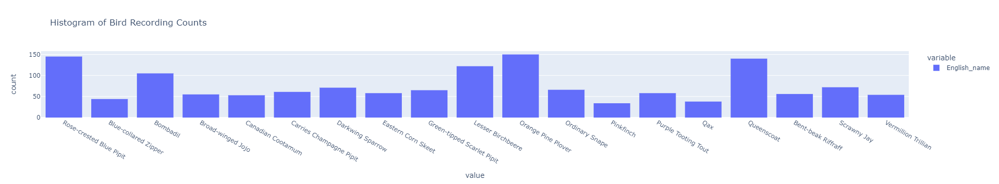

In [17]:
print(birdsDF['English_name'].value_counts())
birdsDF['English_name'].plot(kind='hist', title='Histogram of Bird Recording Counts')

Out of 1477 remaining audio entries, 145 recordings are of the species of interest, the Rose-crested Blue Pipit.

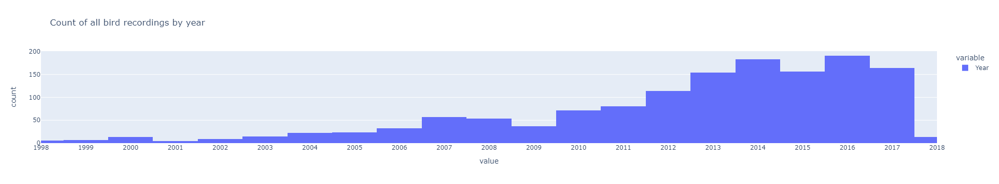

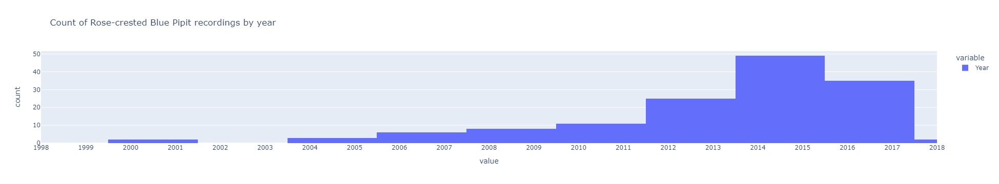

In [18]:
fig = birdsDF['Year'].plot(kind='hist', title = 'Count of all bird recordings by year')
fig.update_layout(
    xaxis = dict(
        tickmode = 'linear',
        dtick = 1,
        range=[1998,2018]
    )
)
fig.show()
fig = birdsDF[birdsDF['English_name'] == 'Rose-crested Blue Pipit']['Year'].plot(kind='hist', title='Count of Rose-crested Blue Pipit recordings by year')
fig.update_layout(
    xaxis = dict(
        tickmode = 'linear',
        dtick = 1,
        range=[1998,2018]
    )
)
fig.show()

We have very lacking information for doing any kind of detailed time series analysis; we're missing the date of Kasios's alleged dumping and the dates of any of their audio recordings, as well as any indication of the methodology for maintaining consistency of the Preserve's recordings. At a glance, there appears to be a drastic drop off in all populations, though on closer examination, it may simply be that recordings stopped being collected in March 2018:

In [19]:
birdsDF[birdsDF['Year'] == 2018]

,File ID,English_name,Vocalization_type,Date,X,Y,Year,distance
2,405901,Rose-crested Blue Pipit,call,2018-02-08,58,76,2018,96.932967
3,405548,Rose-crested Blue Pipit,song,2018-03-10,55,125,2018,125.992063
677,404159,Darkwing Sparrow,call,2018-01-27,12,136,2018,166.469216
678,403458,Darkwing Sparrow,call,2018-02-24,42,60,2018,107.870292
679,402357,Darkwing Sparrow,call,2018-02-09,74,149,2018,131.745968
680,402356,Darkwing Sparrow,call,2018-02-09,69,149,2018,134.617978
681,402355,Darkwing Sparrow,call,2018-02-09,62,75,2018,92.849340
682,402159,Darkwing Sparrow,call,2018-02-07,54,73,2018,99.624294
683,400941,Darkwing Sparrow,song,2018-01-04,140,150,2018,110.290525
992,406225,Lesser Birchbeere,call,2018-03-16,79,53,2018,70.213959


To get a sense of whether this drop off is as significant as it first appeared, we can also compare this data across years looking only at the first months of each year.

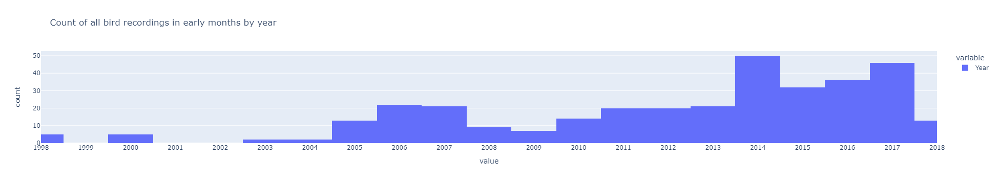

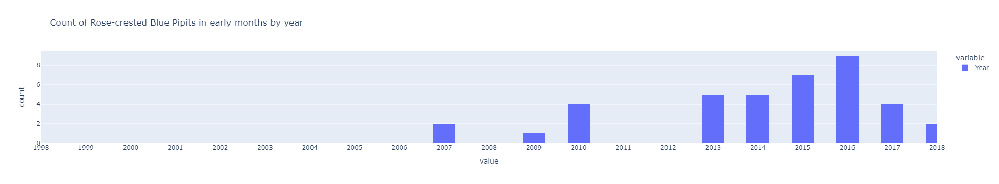

In [105]:
fig = birdsDF[birdsDF['Date'].dt.month.isin([1,2,3])]['Year'].plot(kind='hist', title = 'Count of all bird recordings in early months by year', nbins=50)
fig.update_layout(
    xaxis = dict(
        tickmode = 'linear',
        dtick = 1,
        range=[1998,2018]
    )
)
fig.show()


fig = birdsDF[(birdsDF['Date'].dt.month.isin([1,2,3])) & (birdsDF['English_name'] == 'Rose-crested Blue Pipit')]['Year'].plot(kind='hist', title = 'Count of Rose-crested Blue Pipits in early months by year', nbins=50)
fig.update_layout(
    xaxis = dict(
        tickmode = 'linear',
        dtick = 1,
        range=[1998,2018]
    )
)
fig.show()

After correcting to only look at data from the first few months we have data for in 2018, it still appears there's a significant decrease in recordings taken between 2017 and 2018, potentially implying a similar decrease in populations of actual birds. The Preserve identified 2 counts thus far in 2018. Kasios claims to have collected 11 from unspecified dates. I believe this gives us three possibilities to consider:
* The recordings are legitimate and, adding them to the Preserve's own recordings, comprise record levels of early year Rose-crested Blue Pipit recordings.
* The recordings are legitimate, but too old to be relevant.
* The recordings are miscategorized.

Moving forward, I will assume that the recordings are recent enough to be relevant, as otherwise we would already have a pretty clear indication that the Rose-crested Blue Pipit population (and local birds in general) are in trouble.

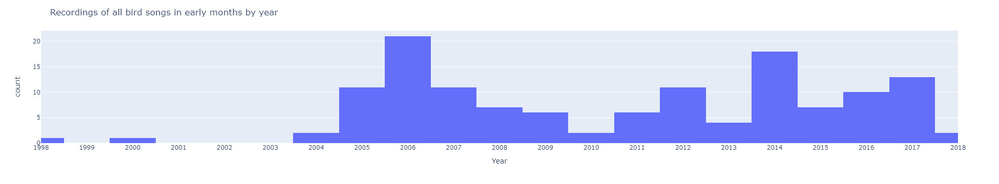

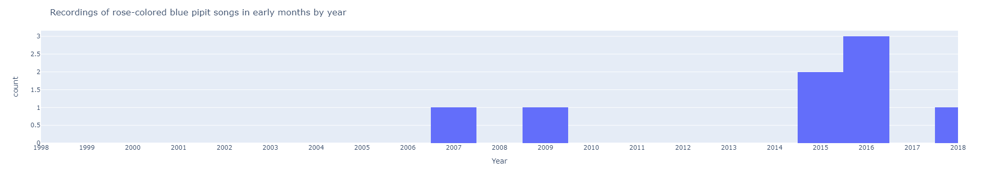

In [106]:
fig = px.histogram(birdsDF[(birdsDF['Date'].dt.month.isin([1,2,3])) & (birdsDF['Vocalization_type'] == 'song')],
                  x='Year',
                  nbins=50)
fig.update_layout(
    title = 'Recordings of all bird songs in early months by year',
    xaxis = dict(
        tickmode = 'linear',
        dtick = 1,
        range=[1998,2018]
    )
)
fig.show()


fig = px.histogram(birdsDF[(birdsDF['Date'].dt.month.isin([1,2,3])) & (birdsDF['English_name'] == 'Rose-crested Blue Pipit') & (birdsDF['Vocalization_type'] == 'song')],
                  x='Year',
                  nbins=20)

fig.update_layout(
    title = 'Recordings of rose-colored blue pipit songs in early months by year',
    xaxis = dict(
        tickmode = 'linear',
        dtick = 1,
        range=[1998,2018]
    )
)
fig.show()

To expand on that--most of these recordings are either calls or songs. Among pipits (and most bird species), singing is typically behavior from males seeking to mate, so it may be the case that a decrease in 

In [21]:
# map graphics
mapImage = Image.open('..\\CheepShots\\CheepShotsData\\LekagulRoadways2018.bmp')
mapMarker = Image.open('..\\CheepShots\\mapmarker.png')

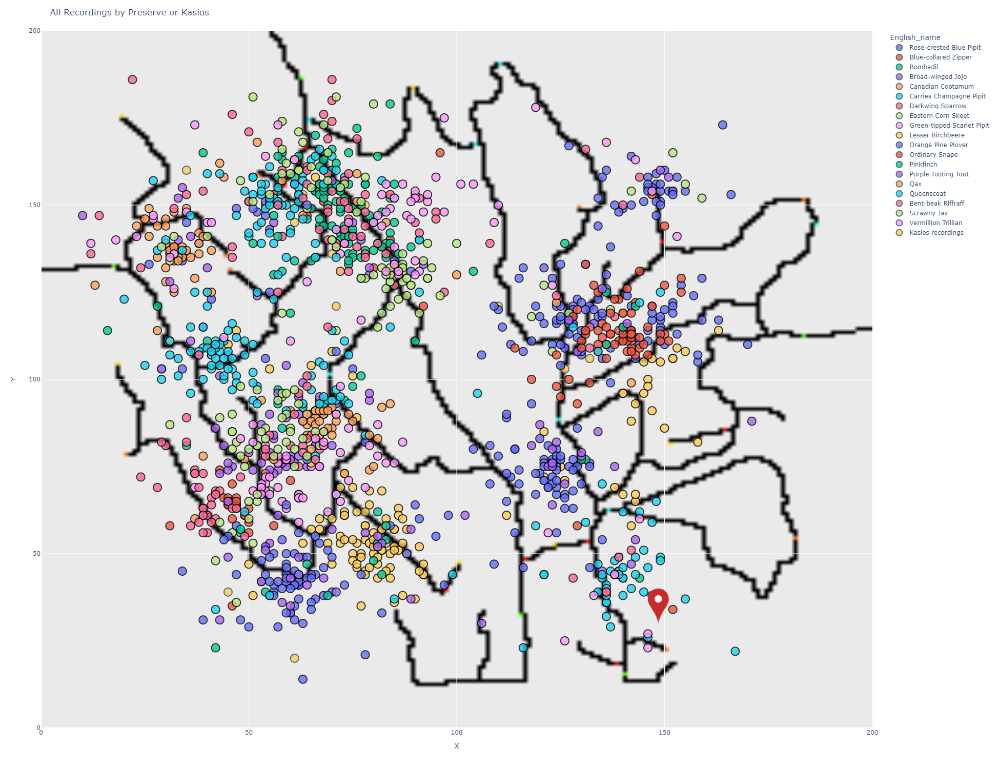

In [22]:
fig = px.scatter(birdsDF, x='X', y='Y', color = 'English_name', color_continuous_scale='blugrn', size='Year') # plotting preserve recordings
fig.add_trace(go.Scatter(x=testBirdsDF['X'], y=testBirdsDF['Y'], mode='markers', name='Kasios recordings' )) # plotting Kasios recordings

# map image
fig.add_layout_image(
    dict(
        source=mapImage,
        xref="x",
        yref="y",
        x=0,
        y=200,
        sizex=200,
        sizey=200,
        sizing="stretch",
        opacity=1,
        layer="below")
)
# map marker for dump site
fig.add_layout_image(
    dict(
        source=mapMarker,
        xref="x",
        yref="y",
        x=146,
        y=40,
        sizex=5,
        sizey=10,
        sizing="stretch",
        opacity=1,
        layer="above")

)
fig.update_traces(marker=dict(size=16,
                              line=dict(width=2,
                                        color='DarkSlateGrey')),
                  opacity=.8,
                  selector=dict(mode='markers'))
# graph layout
fig.update_layout(
    width=1500,
    height=1500,
    xaxis = dict(range=[0,200]),
    yaxis = dict(range=[0,200]),
    title='All Recordings by Preserve or Kasios'
)

fig.show()

Dislpayed is a map plotting every recording in either collection to give an initial impression of the distribution of data. Most species's recording locations seem to cluster somewhat stably, presumably near their nests' locations. 
The map marker indicates the location of the alleged Kasios waste dump.

This is an interactive plotly map, and species's visibility can be toggled by clicking their label in the legend. More specific plots highlighted below.

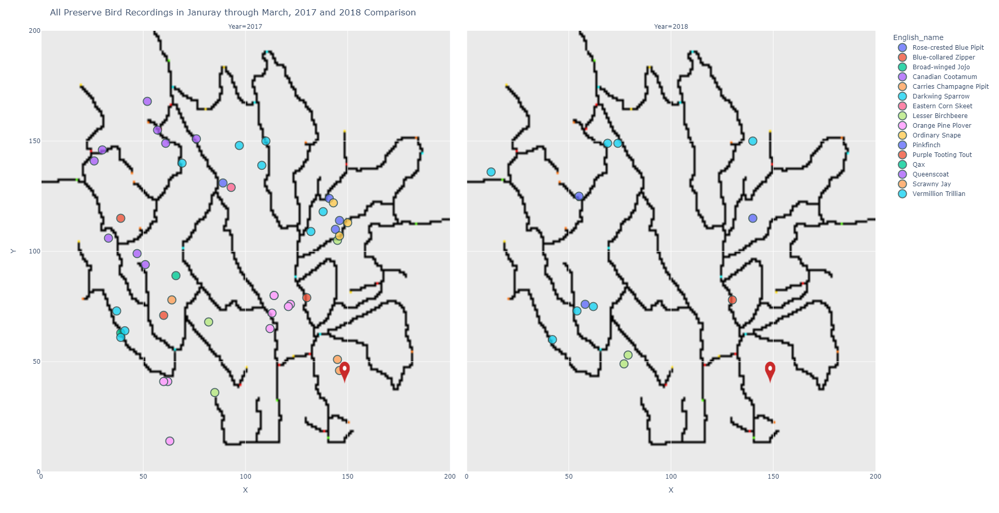

In [23]:
fig = px.scatter(birdsDF[(birdsDF['Date'].dt.month.isin([1,2,3])) & (birdsDF['Year'] > 2016)]     , x='X', y='Y', color = 'English_name', color_continuous_scale='blugrn',
                 facet_col='Year', category_orders={'Year':[2017,2018]})
#fig.add_trace(go.Scatter(x=testBirdsDF[' X'], y=testBirdsDF[' Y'], mode='markers', name='Kasios recordings' ))

fig.add_layout_image(
    dict(
        source=mapImage,
        xref="x",
        yref="y",
        x=0,
        y=200,
        sizex=200,
        sizey=200,
        sizing="stretch",
        opacity=1,
        layer="below")
)
fig.add_layout_image(
    dict(
        source=mapImage,
        xref="x",
        yref="y",
        x=0,
        y=200,
        sizex=200,
        sizey=200,
        sizing="stretch",
        opacity=1,
        layer="below"),
    col=2,row=1
)
fig.add_layout_image(
    dict(
        source=mapMarker,
        xref="x",
        yref="y",
        x=146,
        y=50,
        sizex=5,
        sizey=10,
        sizing="stretch",
        opacity=1,
        layer="above"),
    col=1, row=1

)
fig.add_layout_image(
    dict(
        source=mapMarker,
        xref="x",
        yref="y",
        x=146,
        y=50,
        sizex=5,
        sizey=10,
        sizing="stretch",
        opacity=1,
        layer="above"),
    col=2, row=1

)
fig.update_traces(marker=dict(size=16,
                              line=dict(width=2,
                                        color='DarkSlateGrey')),
                  opacity=.8,
                  selector=dict(mode='markers'))
fig.update_layout(
    width=2000,
    height=1000,
    xaxis = dict(range=[0,200]),
    yaxis = dict(range=[0,200]),
    title='All Preserve Bird Recordings in Januray through March, 2017 and 2018 Comparison'
)

fig.show()

More relevant to the task at hand, these graphs illustrate the reduction in bird call recordings between 2017 and 2018. Again, if the Preserve's recording methods have stayed the same this is already worrying evidence.

In [24]:
# Dataframe for graphing pipit locations
pd.options.mode.chained_assignment = None  
pipits = birdsDF[birdsDF['English_name'] == 'Rose-crested Blue Pipit']
pipits = pipits.sort_values(by=['Year'], ascending=True)

def year_bucket(recording):
    year = recording['Year']
    if year < 2000:
        return 'Before 2000'
    if year < 2010:
        return '2000-2009'
    if year == 2018:
        return '2018'
    else:
        return '2010-2017'    

pipits['bucket'] = pipits.apply(year_bucket, axis=1)

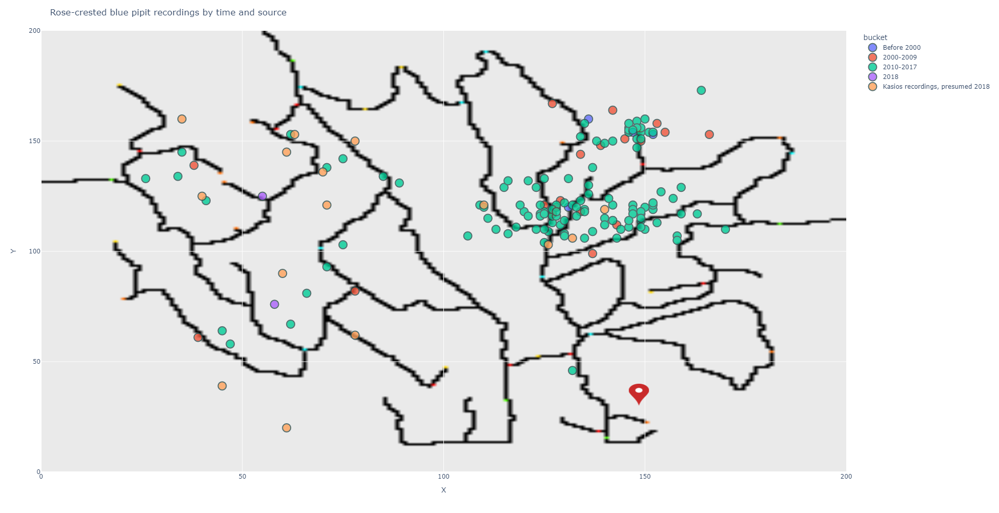

In [25]:
fig = px.scatter(pipits, x='X', y='Y', color = 'bucket', color_continuous_scale='blugrn') # plotting preserve recordings
fig.add_trace(go.Scatter(x=testBirdsDF['X'], y=testBirdsDF['Y'], mode='markers', name='Kasios recordings, presumed 2018' )) # plotting Kasios recordings
# map image
fig.add_layout_image(
    dict(
        source=mapImage,
        xref="x",
        yref="y",
        x=0,
        y=200,
        sizex=200,
        sizey=200,
        sizing="stretch",
        opacity=1,
        layer="below")
)
# map marker for dump site
fig.add_layout_image(
    dict(
        source=mapMarker,
        xref="x",
        yref="y",
        x=146,
        y=40,
        sizex=5,
        sizey=10,
        sizing="stretch",
        opacity=1,
        layer="above")

)
# graph layout
fig.update_layout(
    width=1100,
    height=1000,
    xaxis = dict(range=[0,200]),
    yaxis = dict(range=[0,200]),
    title='Rose-crested blue pipit recordings by time and source'
)

fig.update_traces(marker=dict(size=16,
                              line=dict(width=2,
                                        color='DarkSlateGrey')),
                  opacity=.8,
                  selector=dict(mode='markers'))
fig.show()

This plot shows all locations for confirmed or alleged recordings of rose-crested blue pipit calls.
To reiterate previous explorations:
* As previously mentioned, there are only two confirmed recordings of pipits in recent months
* If the Kasios recordings are recent rose-crested blue pipit recordings, there are instead a record setting number of pipit recordings for the time of year

The new insight that comes from this is:
* Rose-crested blue pipits have always nested in locations that weren't particularly close to the dump site
* The Kasios recordings seem to be taken from scattered spots unrelated to previous pipit nests; based on previous recent behavior we would expect a high density of recordings in the northeast quadrant, while the Kasios recordings are mostly in the west
What this suggests to me is that my decision to focus on distance from the dump site was premature and that if location is considered as a predictor, it should still be handled as typical geospatial data. It also casts more doubt on the Kasios recordings, since they came from unlikely pipit habitats.

***

# Audio Data Feature Extraction

If all we had was the above data, there wouldn't be much more meaningful work to do. The outlook would be grim for the rose-crested blue pipits, whether Kasios was culpable or not. Whether there is anything more to discuss hinges on the authenticity of the Kasios recordings. Because we have no confirmation of the dates or methodology of the recordings, I will be assuming they are recent and honestly sourced, so that confirmation these are recordings of rose-crested blue pipits would be meaningful evidence that the birds's population has not been significantly reduced.

To that end, the other major step of this effort is classifying the species of birds in the recordings supplied by Kasios. To build classifiers that run on audio data, we need to first translate that data into numeric data for processing. In the following cells, I've set up a function that constructs a dataframe with all relevant audio data for visualization and classification. Some of these will be explored in more detail, but the features are:
* y/time series: One-dimensional numeric representation of the audio signal. Effectively the raw data, though it's gone through one level of processing for the machine to read it. All other audio features are derived from this. Value corresponds to amplitude at the time of a given audio sampling.
* rms: Root mean square of the signal strength; effectively measures average level of the signal, or average perceived loudness to the recording device.
* chroma_cens: Measures pitch. Applied to a time series of birdsong, represents the melodic progression of their vocalizations, which tend to be similar across a given species. Normalized to be robust against dynamics, timbre, and articulation, so this is the most commonly used chroma feature for audio matching applications. 
* spectral_rolloff: The spectral rolloff point is the frequency below which 85% of the signal's magnitude distribution is concentrated. 
* melspectrogram: A normal spectrogram represents the loudness of different frequencies in audio recordings. A mel-scaled spectrogram does this but scaled to be relevant to the ranges heard by humans. This is typically used in audio classification tasks as the training set's labels are informed by human ears.
* zero_crossing_rate: The number of times the signal time series crosses the horizontal axis; effectively measures the smoothness of the signal.

In general, these features were selected based on the practices I gleaned from reading existing work in audio classification in human speech and music. The only hyperparameter I've adjusted is the sampling rate of the audio, which I've set to 24000, which is believed to be appropriate to the frequencies of typical bird songs. It may be appropriate to explore other options for hyperparameters for future work.

In [26]:
allBirdsFolder = '..\\CheepShots\\CheepShotsData\\ALL BIRDS'
testBirdsFolder = '..\\CheepShots\\CheepShotsData\\Test Birds from Kasios'

In [27]:
# Function to extract various forms of audio analysis features from birdsong recordings
# Takes a folder path full of mp3 recordings and the IDs of desired recordings (previously selected to be high-quality calls or songs)
# Returns time series representations of recording amplitudes
def load_audio(folder, goodIDs):
    sr = 24000 # audio sampling rate; 24khz sampling rate is supposed to be good for birdsong
    mp3s = [fileName for fileName in os.listdir(folder) if '.mp3' in fileName] # list of .mp3 files in "all birds", labeled audio data

    #mp3s = mp3s[0:2] # Gets a tiny sample of list FOR TESTING
    # Lists to populate with features; attempts made to explain them later
    file_id = []
    time_series= []
    file_name = []

    i=0
    # Loops through each file to get data, features
    for mp3 in mp3s:
        file_name.append(mp3)
        name = mp3.split('.')[0] # name of mp3 file
        current_id = name.split('-')[-1]
        #print(type(current_id))
        
        if i % 10 == 0 :
            print(i)
            print(mp3)
        if int(current_id) in goodIDs:
            file_id.append(name.split('-')[-1])  # file id of recording, matches up with AllBirdsv4.csv
    
            path = folder + '\\' + mp3

            sound = pydub.AudioSegment.from_mp3(path)
            sound.export("..\\CheepShots\\wav files\\" + name + ".wav", format="wav")
            y = librosa.load("..\\CheepShots\\wav files\\" + name + ".wav", sr = sr)[0] # retrieves a numpy array of an audio time series 
            time_series.append(y)
        i+=1
    data = {
        'File ID':file_id,
        'time_series':time_series,
        'file_name':file_name
    }
    audioDF = pd.DataFrame.from_dict(data)
    return audioDF

In [28]:
# Functions to derive features from the time series representations
def apply_rms(row):
    return librosa.feature.rms(y=row['time_series'])

def apply_chroma_cens(row):
    return librosa.feature.chroma_cens(y=row['time_series'], sr=24000)

def apply_spectral_rolloff(row):
    return librosa.feature.spectral_rolloff(y=row['time_series'], sr=24000)

def apply_melspectrogram(row):
    return librosa.feature.melspectrogram(y=row['time_series'], sr=24000)

def apply_zero_crossing_rate(row):
    return librosa.feature.zero_crossing_rate(y=row['time_series'])

The following cells handle the loading and processing of the mp3 files in manageable chunks to avoid running out of memory in the process.

In [29]:
# CONSTRUCTING AND DUMPING allBirdAudioDF
#allBirdsAudioDF = load_audio(allBirdsFolder, list(birdsDF['File ID']))

In [30]:
#allBirdsAudioDF['rms'] = allBirdsAudioDF.apply(apply_rms, axis=1)

In [31]:
#allBirdsAudioDF['chroma_cens'] = allBirdsAudioDF.apply(apply_chroma_cens, axis=1)

In [32]:
#allBirdsAudioDF['spectral_rolloff'] = allBirdsAudioDF.apply(apply_spectral_rolloff, axis=1)

In [33]:
#allBirdsAudioDF['melspectrogram'] = allBirdsAudioDF.apply(apply_melspectrogram, axis=1)

In [34]:
#allBirdsAudioDF['zero_crossing_rate'] = allBirdsAudioDF.apply(apply_zero_crossing_rate, axis=1)

In [35]:
#with open('..\\CheepShots\\allBirdsAudioDF.pkl', 'wb') as f:
#    pkl.dump(allBirdsAudioDF, f)

In [36]:
with open('..\\CheepShots\\allBirdsAudioDF.pkl', 'rb') as f:
    allBirdsAudioDF = pkl.load(f)

In [37]:
#testBirdsAudioDF['rms'] = testBirdsAudioDF.apply(apply_rms, axis=1)
#testBirdsAudioDF['chroma_cens'] = testBirdsAudioDF.apply(apply_chroma_cens, axis=1)
#testBirdsAudioDF['spectral_rolloff'] = testBirdsAudioDF.apply(apply_spectral_rolloff, axis=1)
#testBirdsAudioDF['melspectrogram'] = testBirdsAudioDF.apply(apply_melspectrogram, axis=1)
#testBirdsAudioDF['zero_crossing_rate'] = testBirdsAudioDF.apply(apply_zero_crossing_rate, axis=1)

In [38]:
#with open('..\\CheepShots\\testBirdsAudioDF.pkl', 'wb') as f:
#    pkl.dump(testBirdsAudioDF, f)

In [39]:
with open('..\\CheepShots\\testBirdsAudioDF.pkl', 'rb') as f:
    testBirdsAudioDF = pkl.load(f)

In [40]:
#allBirdsAudioDF = get_audio_features(allBirdsFolder)
#with open('..\\CheepShots\\allBirdsAudioDF.pkl', 'wb') as f:
#    pkl.dump(allBirdsAudioDF, f)

In [41]:
allBirdsAudioDF = allBirdsAudioDF.astype({'File ID': 'int64'})
allBirdsAudioDF.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1447 entries, 0 to 1446
Data columns (total 8 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   File ID             1447 non-null   int64 
 1   time_series         1447 non-null   object
 2   rms                 1447 non-null   object
 3   chroma_cens         1447 non-null   object
 4   spectral_rolloff    1447 non-null   object
 5   melspectrogram      1447 non-null   object
 6   tempogram           1447 non-null   object
 7   zero_crossing_rate  1447 non-null   object
dtypes: int64(1), object(7)
memory usage: 90.6+ KB


In [42]:
fullBirdsDF = birdsDF[['File ID', 'English_name', 'Vocalization_type']].merge(allBirdsAudioDF, left_on='File ID', right_on='File ID')
fullBirdsDF.head()

,File ID,English_name,Vocalization_type,time_series,rms,chroma_cens,spectral_rolloff,melspectrogram,tempogram,zero_crossing_rate
0,406171,Rose-crested Blue Pipit,call,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[[3.9426507e-07, 3.799683e-06, 1.0204668e-05, ...","[[0.2791338, 0.28060257, 0.28199154, 0.2834667...","[[8718.75, 8003.90625, 7839.84375, 7500.0, 723...","[[1.5382265e-13, 2.0906565e-11, 8.072558e-11, ...","[[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0,...","[[0.0546875, 0.22509765625, 0.28466796875, 0.3..."
1,405901,Rose-crested Blue Pipit,call,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[[0.0057713916, 0.008802246, 0.009654834, 0.01...","[[0.2522399, 0.25180367, 0.25138304, 0.2509867...","[[5414.0625, 5062.5, 5050.78125, 5109.375, 520...","[[0.008068651, 0.24643481, 0.29092032, 0.08947...","[[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0,...","[[0.10400390625, 0.11376953125, 0.126953125, 0..."
2,405548,Rose-crested Blue Pipit,song,"[-2.3836119e-08, 2.1482482e-08, -1.7010532e-08...","[[0.0011591074, 0.0017840379, 0.0023161483, 0....","[[0.44497696, 0.44291067, 0.44060433, 0.438112...","[[6867.1875, 5285.15625, 5179.6875, 5566.40625...","[[8.581221e-06, 0.00015662846, 0.0003467471, 0...","[[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0,...","[[0.16845703125, 0.1767578125, 0.18359375, 0.0..."
3,401782,Rose-crested Blue Pipit,song,"[-0.0060734753, -0.0024917044, 0.005846566, 0....","[[0.00070901547, 0.0008721253, 0.0010103488, 0...","[[0.27456918, 0.2729661, 0.27107933, 0.2689935...","[[7277.34375, 7652.34375, 8050.78125, 7195.312...","[[3.540606e-08, 1.1607023e-08, 1.1023644e-08, ...","[[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0,...","[[0.15380859375, 0.2373046875, 0.31591796875, ..."
4,401720,Rose-crested Blue Pipit,call,"[-1.3796724e-05, 7.1318163e-06, 2.572305e-07, ...","[[1.2239049e-05, 1.9283663e-05, 2.8156921e-05,...","[[0.27523795, 0.2738214, 0.2724552, 0.27111897...","[[9703.125, 9363.28125, 9199.21875, 8765.625, ...","[[2.4690565e-09, 5.032317e-09, 3.3255114e-09, ...","[[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0,...","[[0.236328125, 0.34912109375, 0.4501953125, 0...."


In [43]:
#fullTestBirdsDF = testBirdsDF.merge(testBirdsAudioDF)

***

# Audio Visualization

In this section, I set out to clarify how each of these features relates to the problem at hand in the context of classifying birdsong. These features can be visualized graphically to demonstrate their qualities and differences between birds and species. I'll discuss these in more detail as they relate to the rose-crested blue pipit and the Kasios recordings. For now, this admittedly messy grid graphing features of one sampled bird per species is only meant to give an impression of how much these patterns can vary between species, to contrast with the similarities across confirmed recordings of the rose-crested blue pipits. Generally, fluctuations in a graph correlates to patterns in a bird's song suddenly changing in volume, pitch, or timbre. 

In [44]:
def visualization_portfolio(row, col):
    # Setting up subplots
    fig, ax = plt.subplots(ncols = 3, figsize = (40,5))
    fig.suptitle('Audio portfolio for example {name}'.format(name = row[col]) )
    # Waveplot
    plt.axes(ax[0])
    plt.title('Waveplot')
    plt.xlim(0,30)
    plt.ylim(-.4,.4)
    librosa.display.waveshow(y = row['time_series'], sr = 24000)
    # unscaled spectrogram
    plt.axes(ax[1])
    
    D = librosa.amplitude_to_db(np.abs(librosa.stft(row['time_series'])), ref=np.max) #db-scaled specrogram
    librosa.display.specshow(D, y_axis='linear', x_axis='time')
    #librosa.display.specshow(librosa.stft(row['time_series'], y_axis='linear')
    #plt.xlim(0,30)
    plt.title('spectrogram')
    plt.colorbar()
    

    #plt.axes(ax[2])
    #plt.title('chroma_cens')
   # plt.xlim(0,5)
    #DB = librosa.amplitude_to_db(row['chroma_cens'])
    #librosa.display.specshow(DB, y_axis='chroma', x_axis='time', sr = 24000)
    # melspectrogram plot
    plt.axes(ax[2])
    plt.title('melspectrogram')
   # plt.xlim(0,5)
    DB = librosa.amplitude_to_db(row['melspectrogram'])
    librosa.display.specshow(DB, x_axis='time', y_axis='mel', sr = 24000)
    plt.colorbar()
    #librosa.display.specshow(row['melspectrogram'], x_axis='time', y_axis='mel', sr = 24000)

# Example audio portfolio

In [45]:
IPython.display.Audio('..\\CheepShots\\wav files\\Rose-Crested-Blue-Pipit-405548.wav')

This audio comes from a specific recording of a rose-crested blue pipit. Characterized in words, it could be described as quick, escalating trills in a repeated pattern every few seconds, interspersed by gaps in vocalization.

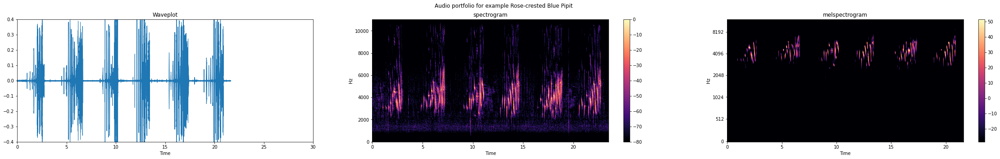

In [46]:
visualization_portfolio(fullBirdsDF[(fullBirdsDF['English_name'] == 'Rose-crested Blue Pipit') & (fullBirdsDF['Vocalization_type'] == 'song')].iloc[1], 'English_name')

For visualization purposes, I'll be showing three features.

The waveplot measures the birdsong's amplitude over time. In the graph here, we can see the pattern of repeated louder trills between relative silences as in the recording.
The spectrogram shows a fairly consistent pattern of the birdsong increasing in frequency over a given trill, starting between 3-5 kHz and escalating to above 6 kHz.
The melspectrogram is a scaling trasnformation of the spectrogram that restricts the audio to ranges humans are generally capable of hearing.


# Audio portfolios for every species example

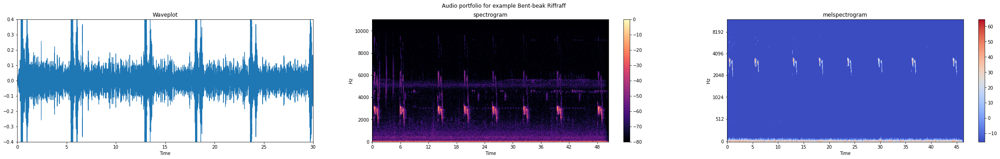

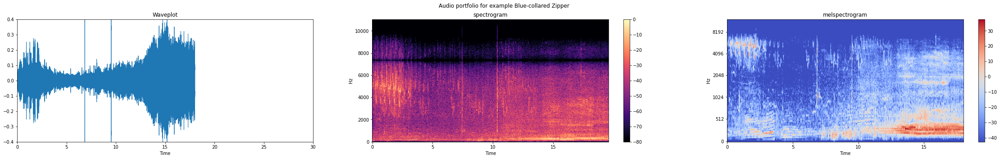

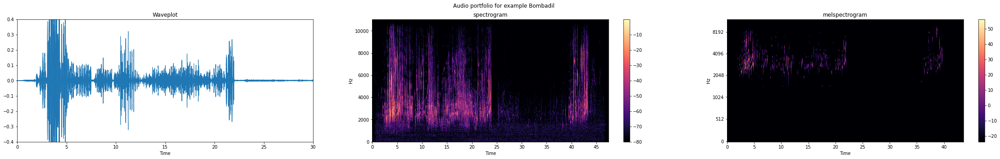

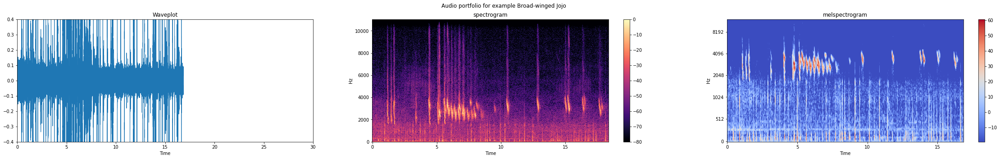

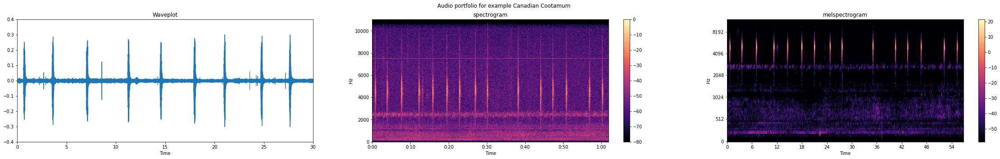

...

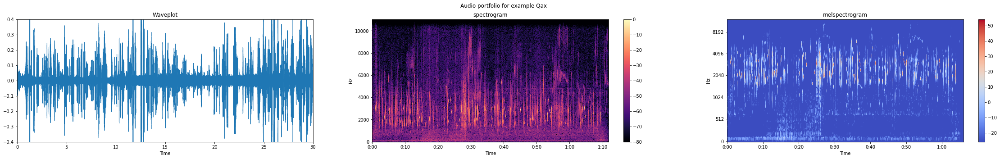

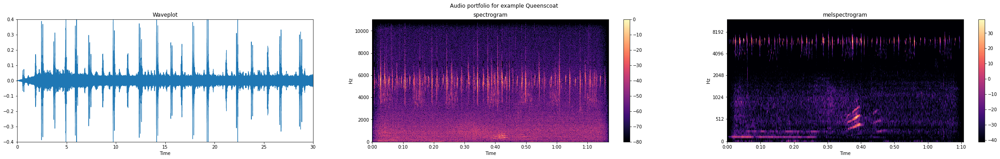

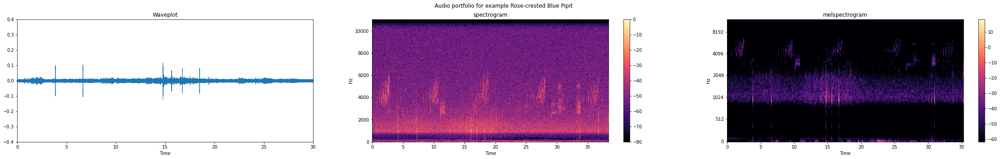

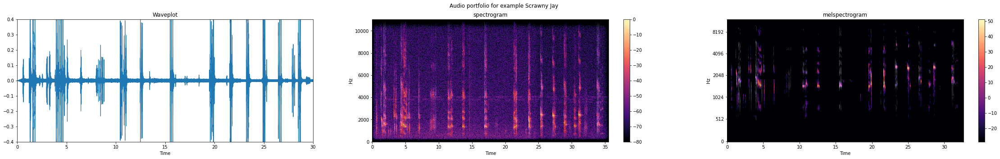

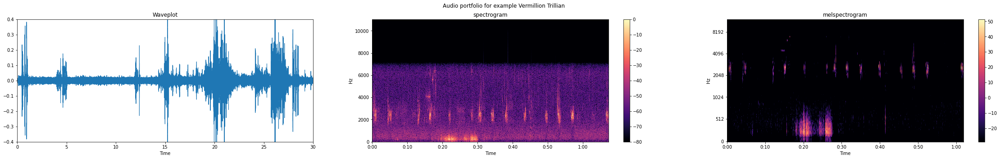

In [47]:
speciesSampleDF = fullBirdsDF[fullBirdsDF['Vocalization_type'] == 'song'].groupby('English_name').sample(1)
for index, row in speciesSampleDF.iterrows():
    visualization_portfolio(row, 'English_name')

Here we can see a pretty wide variety of patterns in the birdsongs as randomly selected representatives of the variety between birdsongs.

For example, the blue-collared zipper has a much faster, quieter song with frequencies that span between 2 and 10 kHz. The broad-winged jojo has a more rapidly oscillating song with frequencies between 2 and 20 kHz. The darkwind sparrow appears to have sharp, singular calls that come every couple of seconds. This specific recording for the lesser bichbeere has an interesting spectrogram, where the density is mostly concentrated around 4 kHz, but with what appears to be quieter echoes at higher and lower frequencies. 

While no one recording of one bird is going to be a perfect example of the entire species, the tempo, loudness, timbre, and frequencies in these patterns will generally have some consistency across individuals, and this should give some impression of how much it can vary between species.

# Audio portfolios for example rose-crested blue pipits

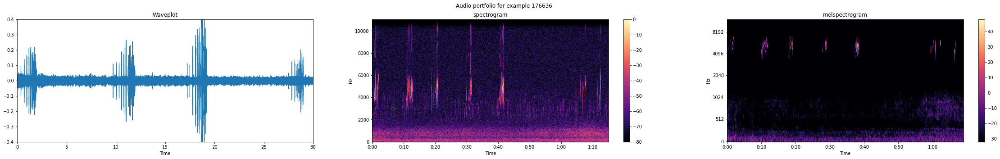

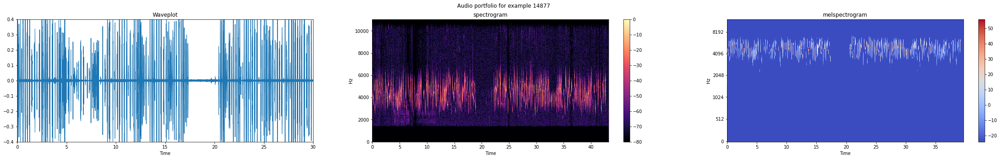

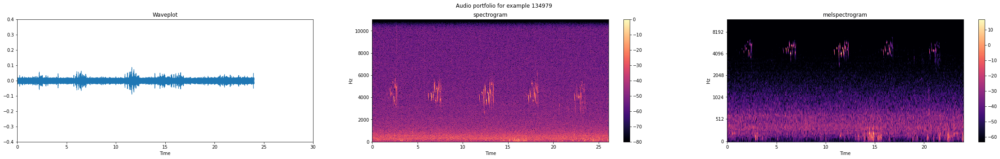

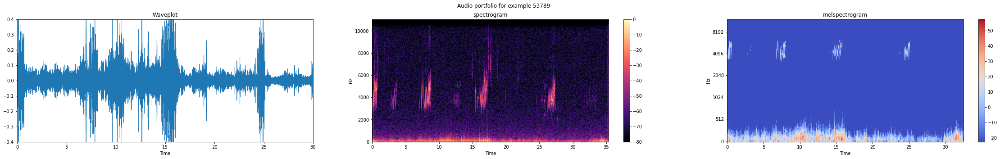

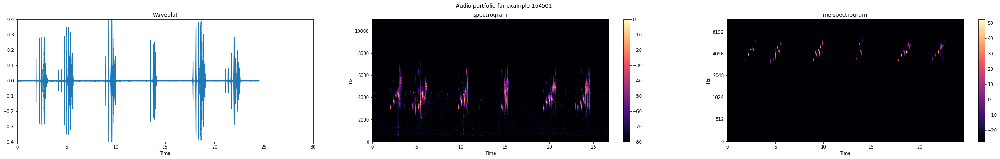

...

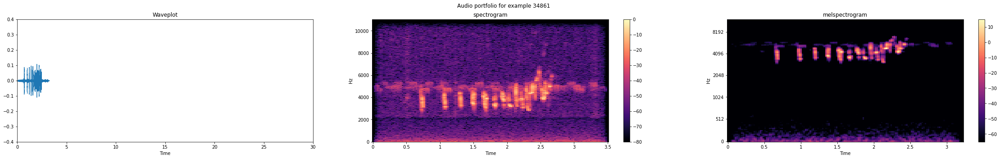

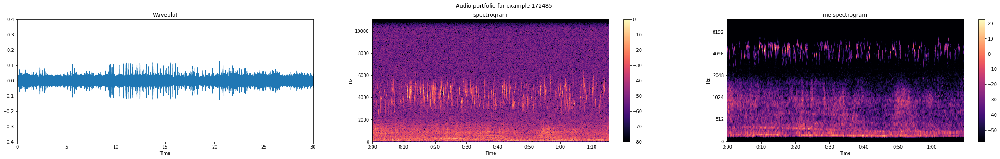

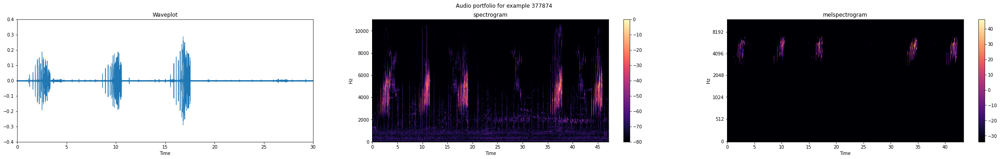

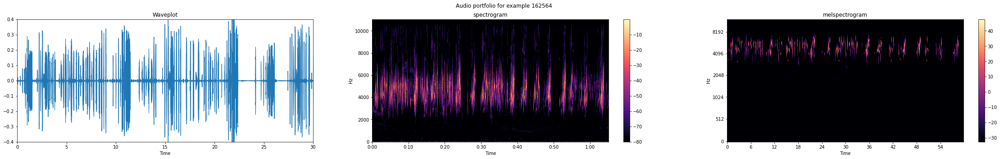

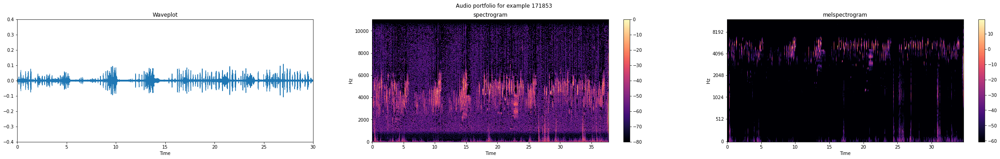

In [48]:
samplePipits = fullBirdsDF[(fullBirdsDF['English_name'] == 'Rose-crested Blue Pipit') & (fullBirdsDF['Vocalization_type'] == 'song') ].sample(15)

for index, row in samplePipits.iterrows():
    visualization_portfolio(row, 'File ID')

In [49]:
samplePipits = fullBirdsDF[(fullBirdsDF['English_name'] == 'Rose-crested Blue Pipit') & (fullBirdsDF['Vocalization_type'] == 'song') ].sample(15)
samplePipits

,File ID,English_name,Vocalization_type,time_series,rms,chroma_cens,spectral_rolloff,melspectrogram,tempogram,zero_crossing_rate
94,304180,Rose-crested Blue Pipit,song,"[-1.233104e-05, 1.7890698e-05, -6.089564e-06, ...","[[9.70118e-06, 3.567146e-05, 0.0004005312, 0.0...","[[0.32646692, 0.3223774, 0.31899798, 0.3163725...","[[11015.625, 11027.34375, 4886.71875, 4417.968...","[[3.3657108e-10, 5.263627e-10, 0.00022657117, ...","[[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0,...","[[0.38037109375, 0.5634765625, 0.5888671875, 0..."
3,401782,Rose-crested Blue Pipit,song,"[-0.0060734753, -0.0024917044, 0.005846566, 0....","[[0.00070901547, 0.0008721253, 0.0010103488, 0...","[[0.27456918, 0.2729661, 0.27107933, 0.2689935...","[[7277.34375, 7652.34375, 8050.78125, 7195.312...","[[3.540606e-08, 1.1607023e-08, 1.1023644e-08, ...","[[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0,...","[[0.15380859375, 0.2373046875, 0.31591796875, ..."
93,305761,Rose-crested Blue Pipit,song,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[[0.0029426839, 0.004001217, 0.004682152, 0.00...","[[0.22752313, 0.22872737, 0.2298762, 0.2309635...","[[5214.84375, 6046.875, 7089.84375, 7558.59375...","[[4.485766e-06, 4.802212e-05, 2.6229609e-05, 1...","[[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0,...","[[0.1572265625, 0.2197265625, 0.2880859375, 0...."
116,171853,Rose-crested Blue Pipit,song,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[[0.0005309536, 0.0006883608, 0.0008698425, 0....","[[0.2283316, 0.23104, 0.2338105, 0.23657377, 0...","[[7148.4375, 7968.75, 8039.0625, 8519.53125, 8...","[[1.5744672e-07, 4.8751375e-05, 0.00074174884,...","[[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0,...","[[0.17529296875, 0.2431640625, 0.33251953125, ..."
132,91351,Rose-crested Blue Pipit,song,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[[0.006013611, 0.009337251, 0.011691356, 0.016...","[[0.2729827, 0.273238, 0.2734077, 0.2735, 0.27...","[[9398.4375, 9363.28125, 9351.5625, 9398.4375,...","[[5.573366e-06, 0.0006598125, 0.005507207, 0.0...","[[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0,...","[[0.22607421875, 0.3271484375, 0.42333984375, ..."
42,105151,Rose-crested Blue Pipit,song,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[[0.011876851, 0.030722741, 0.037071403, 0.051...","[[0.12229573, 0.1158648, 0.10989111, 0.1044485...","[[3316.40625, 2953.125, 1347.65625, 304.6875, ...","[[0.25174326, 6.080653, 26.536663, 37.530632, ...","[[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0,...","[[0.08544921875, 0.08544921875, 0.0859375, 0.0..."
10,364567,Rose-crested Blue Pipit,song,"[0.002652678, 0.003982917, 0.0016496069, 0.002...","[[0.00674845, 0.0070996657, 0.0076649818, 0.00...","[[0.39522743, 0.39223295, 0.38878754, 0.384919...","[[4488.28125, 5355.46875, 7078.125, 7640.625, ...","[[0.038602687, 0.11644286, 0.10161529, 0.08782...","[[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0,...","[[0.03662109375, 0.06884765625, 0.08740234375,..."
43,89862,Rose-crested Blue Pipit,song,"[-2.2439397e-05, 1.3195408e-05, -1.3384478e-05...","[[0.000807318, 0.002062582, 0.0025797202, 0.00...","[[0.24720684, 0.24745803, 0.24765918, 0.247790...","[[9433.59375, 8882.8125, 8859.375, 9082.03125,...","[[1.0230979e-05, 0.0018470798, 0.034467224, 0....","[[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0,...","[[0.1474609375, 0.201171875, 0.26171875, 0.195..."
7,377874,Rose-crested Blue Pipit,song,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[[0.00031573212, 0.0004208485, 0.0004891789, 0...","[[0.2689487, 0.2678483, 0.26681584, 0.2658251,...","[[7628.90625, 7417.96875, 7277.34375, 7570.312...","[[4.5800734e-06, 5.5384517e-05, 3.5978075e-05,...","[[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0,...","[[0.1611328125, 0.2060546875, 0.2529296875, 0...."
59,345802,Rose-crested Blue Pipit,song,"[-0.0003366953, -0.00059584196, -0.0005957434,...","[[0.0010936399, 0.0012872228, 0.0015265334, 0....","[[0.30167732, 0.30983263, 0.31810766, 0.326463...","[[6527.34375, 6773.4375, 6855.46875, 6644.5312..."

Here we see graphs for 15 recordings of rose-crested blue pipit songs. Birds, songs, and recording conditions will vary, but we can still see commonalities here. Ignoring higher amplitudes that are likely noise pollution, and that at times it is much quieter on the recording, there is usually a pretty clear patternof relative quiet interrupted by oscillating trills; in some recordings these are more spaced out, but mostly seem similar to the gaps in vocalizations from the single example recording. In every recording, the spectral energy is concentrated between 3 and 6 kHz in short bursts as in the initial example pipit recording, with other spectral energy being low in amplitude and seemingly randomly distributed, unlikely to come from the actual bird.

# Kasios recordings

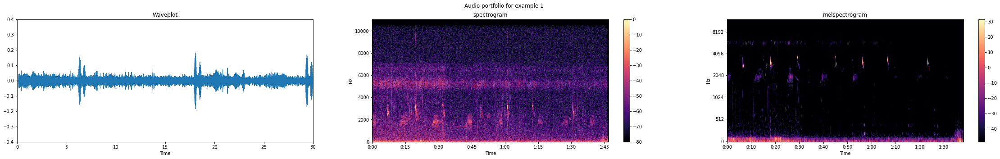

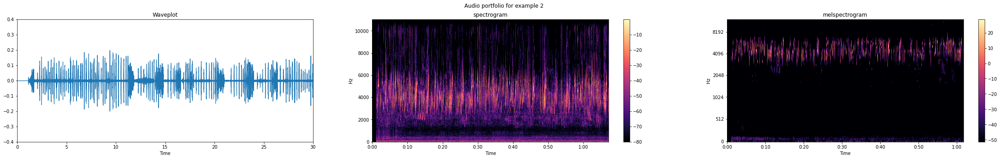

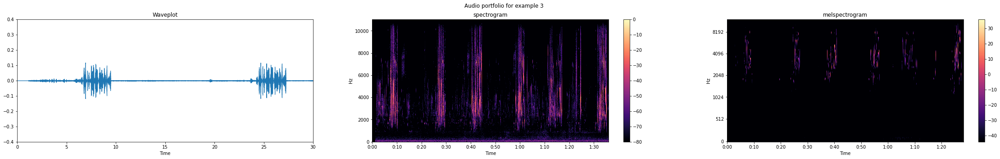

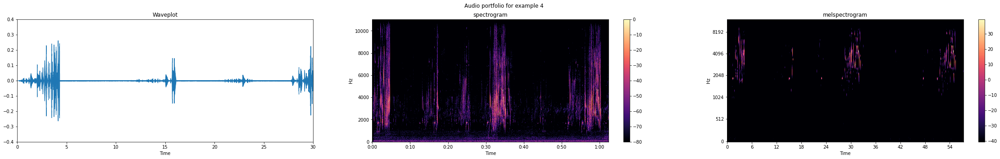

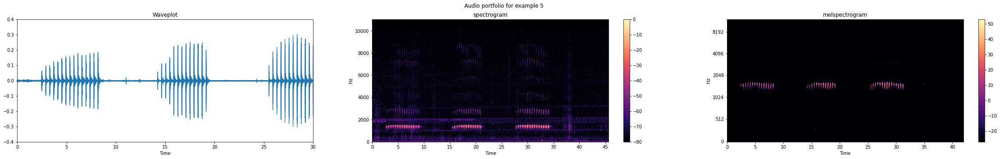

...

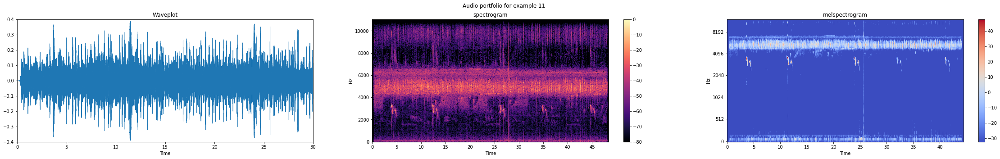

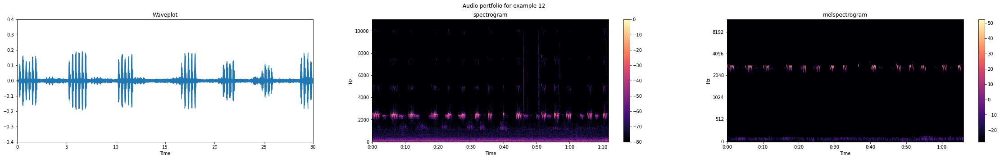

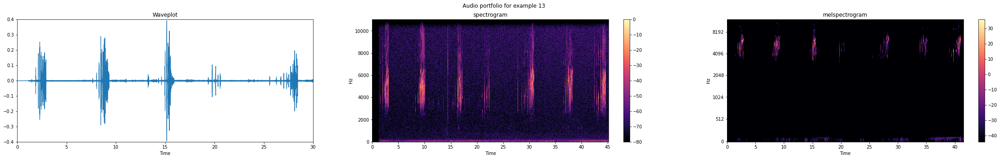

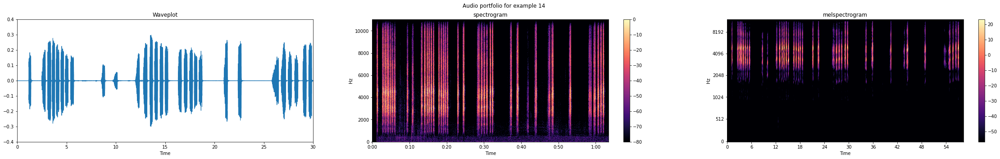

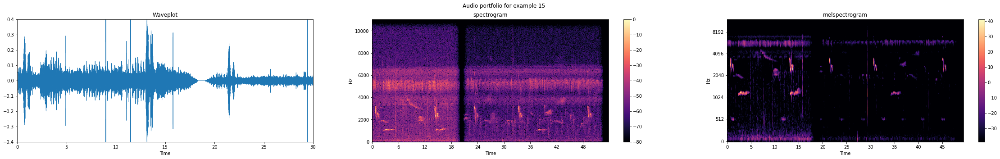

In [50]:
testBirdsAudioDF = testBirdsAudioDF.astype({'File ID': 'int32'}).sort_values(by='File ID')
for index, row in testBirdsAudioDF.iterrows():
    visualization_portfolio(row, 'File ID')

Compared to the recordings of the rose-crested blue pipits, these are much more irregular, immediately making it seem very unlikely that they're from the same species. A few look like possible candidates:
* Recordings 4 and 13 have spaced trills and the 3-6 kHz frequency expected from the rose-crested blue pipit, and look the most likely to be authentic.
* 2 almost looks like a sped-up version of the rose-crested blue pipit pattern, with short trills in the correct frequency range, but much closer together.
* 9 is similar, with the correct frequency range but odd patterns compared to the larger collection of rose-crested blue pipit.
The rest of the recordings look very unlikely, due to ill-fitting pattern's like 10's sudden spikes, or uncharacteristic ranges like 14's spanning from near 0-10 kHz.

***
# Classification

Most of the audio recordings by Kasios are unlikely to belong to rose-crested blue pipits, as they claim they are. If these recordings do not belong to the pipits, it means two things: it is still likely that the local rose-crested blue pipit population is dwindling, and Kasios falsified the evidence in their defense. To avoid biased human judgment, my final computational steps will be to create a classifier that determines whether or not each recording belongs to a rose-crested blue pipit. The extracted features from before were in the form of nested numpy arrays; arrays representing different values of amplitude, frequency, or timbre at different moments in time from different samples. To use this data for a machine learning algorithm, it needs to be flattened into individual values that represent the same information.

In [51]:
features = fullBirdsDF[['English_name','rms','chroma_cens','spectral_rolloff','melspectrogram','zero_crossing_rate']]
features.head()

,English_name,rms,chroma_cens,spectral_rolloff,melspectrogram,zero_crossing_rate
0,Rose-crested Blue Pipit,"[[3.9426507e-07, 3.799683e-06, 1.0204668e-05, ...","[[0.2791338, 0.28060257, 0.28199154, 0.2834667...","[[8718.75, 8003.90625, 7839.84375, 7500.0, 723...","[[1.5382265e-13, 2.0906565e-11, 8.072558e-11, ...","[[0.0546875, 0.22509765625, 0.28466796875, 0.3..."
1,Rose-crested Blue Pipit,"[[0.0057713916, 0.008802246, 0.009654834, 0.01...","[[0.2522399, 0.25180367, 0.25138304, 0.2509867...","[[5414.0625, 5062.5, 5050.78125, 5109.375, 520...","[[0.008068651, 0.24643481, 0.29092032, 0.08947...","[[0.10400390625, 0.11376953125, 0.126953125, 0..."
2,Rose-crested Blue Pipit,"[[0.0011591074, 0.0017840379, 0.0023161483, 0....","[[0.44497696, 0.44291067, 0.44060433, 0.438112...","[[6867.1875, 5285.15625, 5179.6875, 5566.40625...","[[8.581221e-06, 0.00015662846, 0.0003467471, 0...","[[0.16845703125, 0.1767578125, 0.18359375, 0.0..."
3,Rose-crested Blue Pipit,"[[0.00070901547, 0.0008721253, 0.0010103488, 0...","[[0.27456918, 0.2729661, 0.27107933, 0.2689935...","[[7277.34375, 7652.34375, 8050.78125, 7195.312...","[[3.540606e-08, 1.1607023e-08, 1.1023644e-08, ...","[[0.15380859375, 0.2373046875, 0.31591796875, ..."
4,Rose-crested Blue Pipit,"[[1.2239049e-05, 1.9283663e-05, 2.8156921e-05,...","[[0.27523795, 0.2738214, 0.2724552, 0.27111897...","[[9703.125, 9363.28125, 9199.21875, 8765.625, ...","[[2.4690565e-09, 5.032317e-09, 3.3255114e-09, ...","[[0.236328125, 0.34912109375, 0.4501953125, 0...."


In [52]:
testBirdsAudioDF['English_name'] = 'Kasios test'
testBirdsAudioDF.drop(['time_series', 'File ID'], axis=1, inplace=True)

In [56]:
# untangles and flattens the nested arrays of data into a more usable form
# all numpy data has same y dimension of 4605
def explode_features(df, sampleCap = None):
    # loop through columns
    for col in df:
        # only proceeds if the column is numpy array data
        if np.ndim(df.loc[0,col]) > 0:
            if sampleCap == None:
                # gets lengths of array entries to set a cap on how deep into recordings 
                numpyChunks = []
                for row in range(df.shape[0]):
                    numpyChunks.append(df.loc[row,str(col)].shape[1])
            
                sampleCaps = []
                sampleCap = min(numpyChunks)
            # loops through rows of numpy arrays
            for np_row in range(df.loc[0,col].shape[0]):
                # Loops through portions of audio
                for l in range(sampleCap):
                    new_col = str(col) + str(np_row) + "_" + str(l) # creates name for new feature column, derived from original feature name and index information
                    df[new_col] = list(df.loc[element,col][np_row,l] for element in range(df.shape[0]))
            df.drop(col, axis=1, inplace=True)
    return df,sampleCap

In [57]:
unpacked_features, cap = explode_features(features)
unpacked_test, cap = explode_features(testBirdsAudioDF, cap)

In [63]:
unpacked_features.head()

,English_name,rms0_0,rms0_1,rms0_2,rms0_3,rms0_4,rms0_5,rms0_6,rms0_7,rms0_8,...,zero_crossing_rate0_9,zero_crossing_rate0_10,zero_crossing_rate0_11,zero_crossing_rate0_12,zero_crossing_rate0_13,zero_crossing_rate0_14,zero_crossing_rate0_15,zero_crossing_rate0_16,zero_crossing_rate0_17,zero_crossing_rate0_18
0,Rose-crested Blue Pipit,3.942651e-07,0.000004,0.000010,0.000016,0.000023,0.000029,0.000034,0.000045,0.000055,...,0.098145,0.100098,0.102051,0.106445,0.113281,0.110352,0.106934,0.117188,0.141602,0.147949
1,Rose-crested Blue Pipit,5.771392e-03,0.008802,0.009655,0.012215,0.018370,0.019222,0.019872,0.019179,0.015193,...,0.236328,0.237305,0.217773,0.276855,0.319336,0.340820,0.390137,0.413086,0.415527,0.411621
2,Rose-crested Blue Pipit,1.159107e-03,0.001784,0.002316,0.003051,0.003190,0.003153,0.003126,0.002975,0.002714,...,0.052734,0.050293,0.052246,0.053223,0.063477,0.073730,0.073730,0.062012,0.044434,0.034668
3,Rose-crested Blue Pipit,7.090155e-04,0.000872,0.001010,0.000893,0.000894,0.000810,0.000699,0.000822,0.000823,...,0.309570,0.307617,0.294434,0.303223,0.314941,0.323730,0.346680,0.349121,0.318848,0.316406
4,Rose-crested Blue Pipit,1.223905e-05,0.000019,0.000028,0.000036,0.000044,0.000053,0.000065,0.000082,0.000092,...,0.383789,0.396484,0.419434,0.435059,0.441406,0.432617,0.415527,0.411133,0.415039,0.420410


In [64]:
unpacked_test.head()

,English_name,rms0_0,rms0_1,rms0_2,rms0_3,rms0_4,rms0_5,rms0_6,rms0_7,rms0_8,...,zero_crossing_rate0_9,zero_crossing_rate0_10,zero_crossing_rate0_11,zero_crossing_rate0_12,zero_crossing_rate0_13,zero_crossing_rate0_14,zero_crossing_rate0_15,zero_crossing_rate0_16,zero_crossing_rate0_17,zero_crossing_rate0_18
0,Kasios test,0.000005,0.000006,0.000012,0.005801,0.009822,0.011202,0.014905,0.015118,0.016384,...,0.060547,0.084473,0.119629,0.173340,0.205566,0.182617,0.130859,0.074707,0.038086,0.040039
7,Kasios test,0.001984,0.002549,0.002795,0.002653,0.002533,0.002149,0.002218,0.002330,0.002219,...,0.156738,0.134766,0.153320,0.175781,0.187500,0.152832,0.130371,0.097168,0.108887,0.141602
8,Kasios test,0.000005,0.000006,0.000006,0.000007,0.000008,0.000008,0.000009,0.000009,0.000019,...,0.508789,0.479980,0.448730,0.436523,0.433594,0.441895,0.451172,0.449707,0.441895,0.432129
9,Kasios test,0.000523,0.000768,0.001049,0.001359,0.001907,0.003445,0.019365,0.035819,0.047460,...,0.228027,0.230469,0.228027,0.224121,0.218262,0.206543,0.173828,0.145020,0.109863,0.078613
10,Kasios test,0.000005,0.000006,0.000006,0.000007,0.000006,0.000006,0.000006,0.000006,0.000006,...,0.601562,0.589844,0.595215,0.602051,0.592773,0.595215,0.608887,0.609375,0.616699,0.615234


In [66]:
def to_binary(row):
    if row['English_name'] == 'Rose-crested Blue Pipit':
        return 1
    else:
        return 0
final_features = unpacked_features
final_features['target'] = unpacked_features.apply(to_binary, axis=1)
final_features.head()

,English_name,rms0_0,rms0_1,rms0_2,rms0_3,rms0_4,rms0_5,rms0_6,rms0_7,rms0_8,...,zero_crossing_rate0_10,zero_crossing_rate0_11,zero_crossing_rate0_12,zero_crossing_rate0_13,zero_crossing_rate0_14,zero_crossing_rate0_15,zero_crossing_rate0_16,zero_crossing_rate0_17,zero_crossing_rate0_18,target
0,Rose-crested Blue Pipit,3.942651e-07,0.000004,0.000010,0.000016,0.000023,0.000029,0.000034,0.000045,0.000055,...,0.100098,0.102051,0.106445,0.113281,0.110352,0.106934,0.117188,0.141602,0.147949,1
1,Rose-crested Blue Pipit,5.771392e-03,0.008802,0.009655,0.012215,0.018370,0.019222,0.019872,0.019179,0.015193,...,0.237305,0.217773,0.276855,0.319336,0.340820,0.390137,0.413086,0.415527,0.411621,1
2,Rose-crested Blue Pipit,1.159107e-03,0.001784,0.002316,0.003051,0.003190,0.003153,0.003126,0.002975,0.002714,...,0.050293,0.052246,0.053223,0.063477,0.073730,0.073730,0.062012,0.044434,0.034668,1
3,Rose-crested Blue Pipit,7.090155e-04,0.000872,0.001010,0.000893,0.000894,0.000810,0.000699,0.000822,0.000823,...,0.307617,0.294434,0.303223,0.314941,0.323730,0.346680,0.349121,0.318848,0.316406,1
4,Rose-crested Blue Pipit,1.223905e-05,0.000019,0.000028,0.000036,0.000044,0.000053,0.000065,0.000082,0.000092,...,0.396484,0.419434,0.435059,0.441406,0.432617,0.415527,0.411133,0.415039,0.420410,1


This new dataframe has each feature previously created flattened into a somewhat arbitrary number of columns. Each column, now, represents some aspect of the initial time series representation of the recordings, at a specifice moment in a specific sample.

I want to highlight this because it is a possible shortcoming to my approach to this task, resulting from my inexperience with audio data and misunderstanding what my final features would be. What I've effectively done is set a cutoff point so that each recording is only considered until a set length. While this isn't necessarily a "wrong" approach, and is done, it results in a significant loss of data. Other approaches I could have taken would include setting different sampling rates, either accepting the rates the audio was recorded at, or scaling it to the length of the audio. Alternatively, if limiting the time window, it could have been limited more intelligently, truncating leading silence.

With more time, I may try one of these other methods. However, loading the data in is the slowest part of this entire process, and I believe the classifiers already perform adequately for answering the core questions of this project.

In [67]:
y = final_features[['target']].values.ravel() # Target for binary classification
#y = final_features[['English_name']].values.ravel() # Target for multi-class classification
X = final_features.drop(['English_name', 'target'], axis=1)

In [68]:
final_features['target'].value_counts()

0    1302
1     145
Name: target, dtype: int64

Using a binary classifier means our two classes are "rose-crested blue pipit" and "anything that isn't a rose-creted blue pipit". Since there was a somewhat balanced distribution of bird species recordings, this reults in incredibly lopsided binary classes. My solution to this is to synthetically upsample new data points using the SMOTE library. This generates "fake" rose-crested blue pipit recordings with believable features typical of the data to balance the classes.

In [69]:
# Balancing classes
smote = SMOTE() # initializing SMOTE algorithm to balance classes
# fit predictor and target variable
X_smote, y_smote = smote.fit_resample(X, y)
X_train, X_test, y_train, y_test = train_test_split(X_smote, y_smote, test_size=0.30) # train-test split

In [72]:
random_seed = 123
pipe = Pipeline(steps=[('estimator', MultinomialNB())])
params_grid = [{'estimator':[MultinomialNB()],
            'estimator__alpha':[1,.1,.01]
                },
            {'estimator':[RandomForestClassifier()],
            'estimator__max_features':['auto','sqrt','log2'],
            'estimator__bootstrap': [True, False],
            'estimator__n_jobs':[5],
            'estimator__random_state': [random_seed]
                },
            {'estimator':[SGDClassifier()],
            'estimator__alpha':[.0001,.001,.01],
            'estimator__max_iter': [5000],
            'estimator__loss': ['hinge','log','perceptron'],
            'estimator__n_jobs': [5],
            'estimator__random_state': [random_seed]
                },
            {'estimator':[KNeighborsClassifier()],
             'estimator__n_neighbors':[3,5,7,10]
                },
            {'estimator':[MLPClassifier()],
             'estimator__activation':['logistic','relu'],
             'estimator__alpha':[.0001,.001,.01],
             'estimator__hidden_layer_sizes':[100,150,200]}
            


            ]
grid = GridSearchCV(pipe, params_grid, scoring = 'recall')
grid.fit(X_smote,y_smote)
output = open('grid', 'wb')

print(grid.best_params_)
print(grid.best_score_)

{'estimator': KNeighborsClassifier(n_neighbors=3), 'estimator__n_neighbors': 3}
0.9900029472443265


A number of classifiers are compared to find the best one for the situation. For this instance, I compared them based on recall to be sure we don't have any false negatives. This is to be as generous as possible to Kasios; I don't want to risk falsely accusing them or giving up on the local pipit population too soon by missing real pipits. The winning estimator is a random forest classifier.

In [75]:
def evaluate_model(clf, y_true, y_pred):
  print(classification_report(y_true, y_pred, target_names=['Not-a-pipit','Pipit']))
  cm = confusion_matrix(y_true, y_pred, labels=clf.classes_)
  
  disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                                display_labels=['Not-a-pipit','Pipit'])
  fig, ax = plt.subplots(figsize=(10,10))
  disp.plot(ax=ax, cmap='PuBuGn') 

In [73]:
good_model = KNeighborsClassifier(n_neighbors=3)
good_model.fit(X_train, y_train)
y_pred=good_model.predict(X_test)

              precision    recall  f1-score   support

 Not-a-pipit       0.97      0.72      0.83       375
       Pipit       0.79      0.98      0.88       407

    accuracy                           0.86       782
   macro avg       0.88      0.85      0.85       782
weighted avg       0.88      0.86      0.85       782



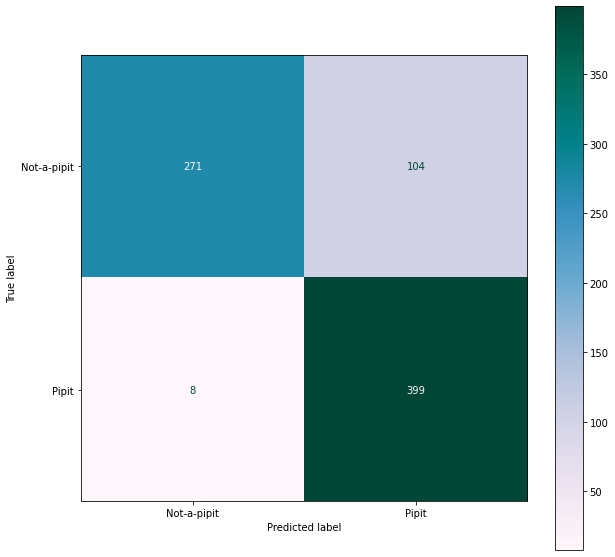

In [76]:
evaluate_model(good_model, y_test, y_pred)

While this could be improved, an overall accuracy of 0.86 is better than I expected considering the background noise pollution in the audio and the dropped data, and I feel comfortable calling this "pretty good". More importantly, 0.98 recall for rose-crested blue-pipits all but guarantees the most generous possible appraisal of Kasios's recordings.

In [78]:
X_test = unpacked_test.drop('English_name', axis=1)
y_pred=good_model.predict(X_test)
y_pred

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0], dtype=int64)

In the end, only the 13th Kasios recording was classified as a rose-crested blue pipit. While I think it's possible the classifier missed that recording 4 is also real, it's incredibly unlikely that it would misclassify all 14 of the other negative results with 0.98 recall.

***

# Conclusion

We can say with high confidence that most of the recordings Kasios submitted as alleged rose-crested blue pipit calls or songs came from other species of birds. This means two things:
* We still have substantial evidence that the local rose-crested blue pipit population has been either devastated or displaced.
* Kasios was either dishonest or careless in preparing their evidence of the birds' well-being.

While it is at least suspicious that there seems to be a sudden downward trend of recorded birdsong near the dump site and in the Preserve as a whole, I do not have enough information to make any statement in regards to Kasios's culpability in harming the Preserve's birds. I can, however, say that Kasios likely falsified evidence and should not be trusted to investigate its own alleged crimes.

The steps I've taken to classify the rose-crested blue pipit seem to (in some limited testing) work well for the rest of the species recorded in this data set, as well. However, if one were to try to replicate these steps, it would be good to be more careful about the initial loading than I was to avoid excessive discarding of data. I believe it would be an improvement to either adjust the sampling rate or more specifically curate what portions of audios are discarded. For future work it may also be useful to consider the geographic position of recordings, as most of them were immediately suspicious based on their locations being distant from previous known rose-crested blue pipit nests. 

For the task at hand, however, these results should suffice.

***

Useful links I consulted:
* https://librosa.org/doc/main/feature.html documentation for librosa, the library used for audio feature extraction

Introductions to doing this kind of task:
* https://www.analyticsvidhya.com/blog/2021/06/introduction-to-audio-classification/
* https://towardsdatascience.com/urban-sound-classification-with-librosa-nuanced-cross-validation-5b5eb3d9ee30 

These informed my choice of sampling rate, which might have been a mistake:
* https://www.wildlifeacoustics.com/uploads/video-downloads/Video_Script_SM4_Audio_Settings.pdf 
* https://librosa.org/blog/2019/07/17/resample-on-load/ 

Guidance on features for audio classification:
* https://ieeexplore.ieee.org/document/1386250 
* https://towardsdatascience.com/audio-deep-learning-made-simple-part-2-why-mel-spectrograms-perform-better-aad889a93505 
* https://towardsdatascience.com/how-i-understood-what-features-to-consider-while-training-audio-files-eedfb6e9002b -
* https://athina-b.medium.com/audio-signal-feature-extraction-for-analysis-507861717dc1 
* https://medium.com/analytics-vidhya/understanding-the-mel-spectrogram-fca2afa2ce53 
* https://www.audiolabs-erlangen.de/content/05-fau/professor/00-mueller/03-publications/2005_MuellerKurthClausen_ChromaAudioFeatures_WASPAA.pdf 
* https://musicinformationretrieval.com/chroma.html
* https://librosa.org/doc/0.9.1/generated/librosa.feature.chroma_cens.html#librosa.feature.chroma_cens

# 